# **Oriented Object Detection with YOLO11 Utilizing the DIOR-R Dataset**

The [YOLO11](https://docs.ultralytics.com/models/yolo11/) model from [Ultralytics](https://www.ultralytics.com/) is the latest and most advanced model in the YOLO series for real-time object detection. For Oriented Bounding Box (OBB) Object Detection tasks, the model is pretrained on the [DOTAv1](https://captain-whu.github.io/DOTA/index.html) dataset, a large-scale dataset for aerial object detection, containing 15 categories, 2806 images, and 188,282 annotated instances with oriented bounding boxes. This pretraining results in the [YOLO11-OBB](https://github.com/ultralytics/ultralytics/tree/main/ultralytics/cfg/models/11) models. Oriented object detection is more challenging than traditional object detection as it introduces a fifth coordinate (an additional angle) to precisely locate objects in an image, which is particularly useful for aerial and satellite images.

In this notebook, the **YOLO11l-OBB** model is specifically fine-tuned using the [DIOR-R](https://gcheng-nwpu.github.io/#Datasets) dataset, a benchmark for object detection in optical remote sensing images. Optical remote sensing captures high-resolution images with surface details, showing colors and shapes similar to what we would observe with the naked eye. This level of detail is essential to capture the specific visual characteristics and structures of objects in terrestrial environments, allowing for the training of advanced object detection models for aerial and satellite imagery.

The DIOR-R dataset includes 23,463 images and 192,518 annotated instances with oriented bounding boxes, which is particularly useful in optical remote sensing as satellite or drone views often display objects in varying orientations due to observation angles. The dataset contains 20 object classes and is divided into 5862 images for training, 5863 for validation, and 11,738 for testing.

## **Imports**

In [ ]:
# Installation of the Ultralytics library
!pip install ultralytics -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 886.3/886.3 kB 28.6 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
from PIL import Image
from google.colab import drive
from glob import glob
from IPython.display import clear_output, display, Video
import yaml
import shutil
from tqdm.auto import tqdm
import requests
import os

# Necessary in Colab with Ultralytics to prevent path-related encoding errors
import locale
locale.getpreferredencoding = lambda: "UTF-8"

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# Mount Google Drive in Colab
drive.mount("/content/drive")

Mounted at /content/drive


## **Parameters**

In [ ]:
batch_size = 16
epochs = 25
patience = 5
zip_dataset = "/content/drive/MyDrive/Datasets/DIOR-R.zip"
path_dataset = "/content/datasets/DIOR-R"
path_save_results = "/content/drive/MyDrive/Ultralytics"

## **Preparing the Dataset for Training**

### **Load the Dataset**

The download, along with all the preprocessing and analysis of the DIOR-R dataset, has been completed in the following notebook: [Preprocessing_DIOR-R](https://github.com/JersonGB22/ObjectDetection-TensorFlow-PyTorch/blob/main/Preprocessing/Preprocessing_DIOR-R.ipynb). Therefore, in this case, it will only be necessary to unzip the zip file.

In [ ]:
!unzip -q $zip_dataset -d /content/datasets

### **Visualization Example**

With Ultralytics, data augmentation, training, and inference are very straightforward processes, so it is not even necessary to manually plot the images with their respective oriented bounding boxes. However, to better visualize predictions when there are too many instances, a function is created with the help of Matplotlib and OpenCV. This function allows for clearer plotting of the oriented bounding boxes and also addresses the challenge of correctly graphing them, improving the visual interpretation of the results.

In [ ]:
# Extract the class names from the YAML file
with open(os.path.join(path_dataset, "data_val.yaml"), "r") as archivo:
    class_names = yaml.safe_load(archivo)["names"]

print(class_names)

['airplane', 'airport', 'baseball field', 'basketball court', 'bridge', 'chimney', 'dam', 'expressway service area', 'expressway toll station', 'golf course', 'ground track field', 'harbor', 'overpass', 'ship', 'stadium', 'storage tank', 'tennis court', 'train station', 'vehicle', 'wind mill']


In [ ]:
colors = [
    "#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd",
    "#8c564b", "#e377c2", "#7f7f7f", "#bcbd22", "#17becf",
    "#9edae5", "#ff9896", "#c5b0d5", "#aec7e8", "#ffbb78",
    "#98df8a", "#ff6347", "#ff1493", "#20b2aa", "#800080"
]


#Function to plot images with OBB
def plot_image_annotation(images, annotations, with_conf=False, save=False, path_save=""):
  n_rows = len(images)
  fig, axes = plt.subplots(n_rows, 1, figsize=(8, n_rows*8))
  axes = axes.flatten() if n_rows > 1 else [axes]

  for j, (image, annotation) in enumerate(zip(images, annotations)):
    image = Image.open(image)
    shape = np.array(image).shape
    axes[j].imshow(image)

    annotation = np.loadtxt(annotation)
    annotation = annotation[None, :] if annotation.ndim == 1 else annotation
    classes = annotation[:, 0].astype(np.int32)
    boxes = annotation[:, 1:9]

    for i in range(len(boxes)):
      cls = classes[i]

      box = boxes[i].reshape((-1, 2))
      box[:, 0] *= shape[1]
      box[:, 1] *= shape[0]

      # Convert the polygon to a minimum area rectangle (x_center, y_center, width, height, angle)
      box = cv2.minAreaRect(box.astype(np.int32))
      angle = box[-1]

      # Find the 4 vertices of the rotated rectangle
      box = cv2.boxPoints(box)

      rect = patches.Polygon(box, linewidth=1.5, edgecolor=colors[cls], facecolor="none")
      axes[j].add_patch(rect)

      s = f"{class_names[cls]} {annotation[i, 9]:.2f}" if with_conf else class_names[cls]

      axes[j].text(
          x=box[0, 0], y=box[0, 1], s=s,
          color="black", fontsize=5.5, fontweight="bold", ha="left", va="bottom",
          bbox={"boxstyle": "square,pad=0", "facecolor": colors[cls], "edgecolor": colors[cls], "alpha": 0.7},
          rotation=90-angle
      )

    axes[j].axis("off")

  plt.tight_layout()
  # Save images
  if save:
    plt.savefig(path_save, bbox_inches="tight", pad_inches=0.05)

  plt.show()

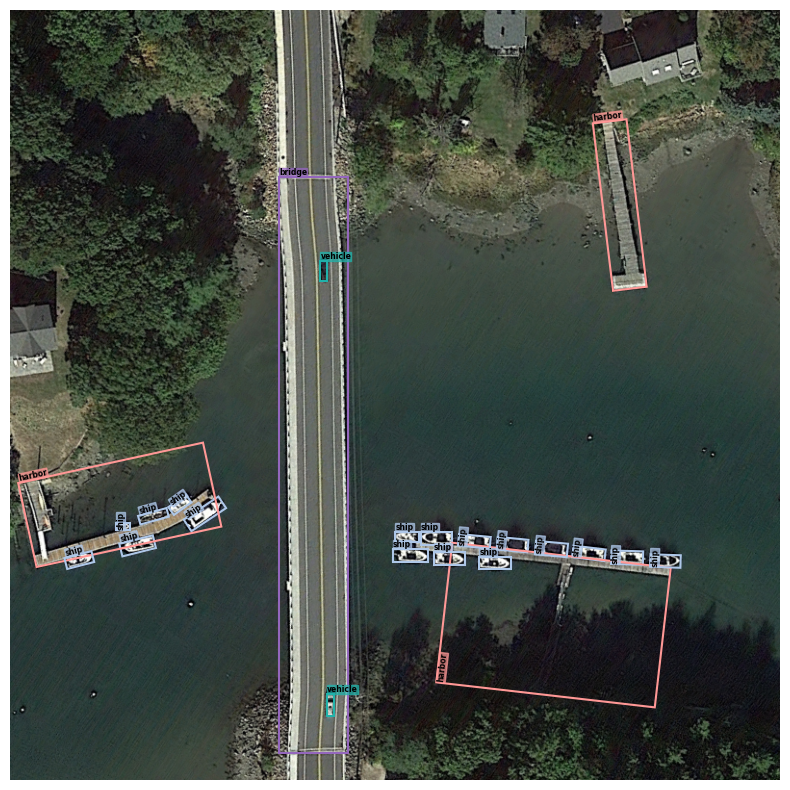

In [ ]:
id = "00100"

plot_image_annotation(
    [f"/content/datasets/DIOR-R/train/images/{id}.jpg"],
    [f"/content/datasets/DIOR-R/train/labels/{id}.txt"]
)

## **Initializing and Training the Model**

The YOLO model downloaded from Ultralytics' GitHub is implemented in **PyTorch**, which means it cannot currently be trained on Colab's TPU to speed up the process. In this case, the specific version used is **YOLO11l-OBB**, which has over 25 million parameters. With Ultralytics, there's no need to specify the optimizer or learning rate, as these are automatically chosen based on the dataset size and number of epochs. In this particular case, based on experimentation, this setup is the most suitable for the DIOR-R dataset, allowing the model to converge effectively in just 25 epochs. Additionally, freezing the backbone layers does not improve the model's performance, so it is not applied. Since most of the instances in the images are not very small, an image size of 640 (`imgsz`) is chosen to achieve the best results in the shortest time possible. From my experimentation, training with an image size of 1024 only slightly improves performance, but more than doubles the training time.

Regarding data augmentation to make the model more robust and prevent overfitting, with Ultralytics, it is simply a matter of adjusting the values of each transformation since everything is implemented with the [Albumentations](https://albumentations.ai/), [OpenCV](https://opencv.org/) and [Torchvision](https://pytorch.org/vision/stable/index.html) libraries.

During training, the YOLO model uses the following three losses:

- **box_loss**: This is the **Complete Intersection over Union (CIoU) Loss**. This loss function considers not only the overlap between the predicted and actual bounding boxes but also the distance between their centers and the aspect ratio. This makes it a more thorough metric for assessing box alignment. It surpasses the performance of IoU (Intersection over Union), GIoU (Generalized IoU), and DIoU (Distance IoU) losses.

- **cls_loss**: This is the **Binary Cross Entropy loss with logits** applied to the model's classifier.

- **dfl_loss**: This refers to the **Distribution Focal Loss (DFL)**, an enhanced variant of the focal loss aimed at giving greater emphasis to difficult-to-classify instances. It modifies the focal loss according to the class distribution, enhancing the model's sensitivity to minority classes and helping to address class imbalance.

Lastly, since the training time for YOLO models can be long, Ultralytics offers options to resume training from where it left off. This is useful in case of interruptions or if the free GPU time of 3 hours and 40 minutes on Google Colab is exceeded. In this case, it won't be necessary as the total training time only takes approximately **3.21 hours**.




In [ ]:
## @title Choose Whether to Resume Training
pretrained = False # @param {type:"boolean"}

In [ ]:
name_project = os.path.join(path_save_results, "OBB_ObjectDetection_YOLO11l_DIOR-R")

In [ ]:
if pretrained:
  model = YOLO(os.path.join(name_project, "weights/last.pt"))
else:
  model = YOLO("yolo11l-obb.pt")

model.info()

100%|██████████| 50.7M/50.7M [00:00<00:00, 82.4MB/s]


YOLO11l-obb summary: 656 layers, 26,170,880 parameters, 0 gradients, 91.0 GFLOPs


(656, 26170880, 0, 91.030016)

In [ ]:
if pretrained:
  results = model.train(resume=True)

else:
  results = model.train(
      data=os.path.join(path_dataset, "data_val.yaml"),
      epochs=epochs,
      patience=patience,
      batch=batch_size,
      imgsz=640,
      deterministic=True, #Allows for reproducibility of the training
      verbose=False,
      project=path_save_results,
      name=name_project,

  # Data Augmentation
      hsv_h=0.015, #Randomly adjusts the hue of the image within the range [1-0.015; 1+0.015]
      hsv_s=0.3, #Randomly adjusts the saturation of the image within the range [1-0.3; 1+0.3]
      hsv_v=0.4, #Randomly adjusts the brightness of the image within the range [1-0.4; 1+0.4]
      translate=0.1, #Randomly shifts the image horizontally and vertically by up to 10% of its original size
      scale=0.25, #Randomly scales the image size within the range of [100%-25%; 100%+25%]
      fliplr=0.5, #Horizontal flip of the image with a probability of 0.5
      mosaic=1.0, #Combines 4 images into one with a probability of 1
      close_mosaic=0, #Allows applying the mosaic in all epochs
      erasing=0.25 #25% probability of applying random erasure using 'torchvision.transforms.RandomErasing'
  )

Ultralytics 8.3.29 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=obb, mode=train, model=yolo11l-obb.pt, data=/content/datasets/DIOR-R/data_val.yaml, epochs=25, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/Ultralytics, name=OBB_ObjectDetection_YOLO11l_DIOR-R, exist_ok=False, pretrained=True, optimizer=auto, verbose=False, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_con

100%|██████████| 755k/755k [00:00<00:00, 16.2MB/s]


Overriding model.yaml nc=80 with nc=20

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.nn.modules.block.C3k2            [512, 512, 2, True]           
  7                  -1  1   2360320  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 90.7MB/s]


AMP: checks passed ✅


train: Scanning /content/datasets/DIOR-R/train/labels... 5862 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5862/5862 [00:10<00:00, 543.68it/s]


train: New cache created: /content/datasets/DIOR-R/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/datasets/DIOR-R/val/labels... 5863 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5863/5863 [00:22<00:00, 257.99it/s]


val: New cache created: /content/datasets/DIOR-R/val/labels.cache
Plotting labels to /content/drive/MyDrive/Ultralytics/OBB_ObjectDetection_YOLO11l_DIOR-R/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000417, momentum=0.9) with parameter groups 173 weight(decay=0.0), 183 weight(decay=0.0005), 182 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/Ultralytics/OBB_ObjectDetection_YOLO11l_DIOR-R
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/25      11.8G     0.9395      2.199       1.98         55        640: 100%|██████████| 367/367 [05:18<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:41<00:00,  2.28it/s]


                   all       5863      35439      0.716      0.645      0.659      0.494

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/25      11.4G     0.8634      0.916      1.885         28        640: 100%|██████████| 367/367 [05:10<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:39<00:00,  2.30it/s]


                   all       5863      35439      0.735      0.654      0.706      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/25      11.8G     0.8776     0.8371      1.933         52        640: 100%|██████████| 367/367 [05:06<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:37<00:00,  2.33it/s]


                   all       5863      35439      0.781      0.695      0.735      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/25      12.3G     0.8627     0.7987      1.943         30        640: 100%|██████████| 367/367 [05:02<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:39<00:00,  2.30it/s]


                   all       5863      35439      0.788      0.697      0.742      0.549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/25      12.1G     0.8364     0.7338        1.9         41        640: 100%|██████████| 367/367 [05:03<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:38<00:00,  2.32it/s]


                   all       5863      35439      0.771      0.718      0.754      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/25      11.8G     0.8112     0.6986      1.887         38        640: 100%|██████████| 367/367 [05:02<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:39<00:00,  2.30it/s]


                   all       5863      35439      0.806      0.718      0.758      0.582

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/25      12.6G     0.7997     0.6823      1.889         34        640: 100%|██████████| 367/367 [05:02<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:37<00:00,  2.33it/s]


                   all       5863      35439      0.838      0.735      0.776      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/25      12.5G     0.7817     0.6519      1.848         30        640: 100%|██████████| 367/367 [05:01<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:38<00:00,  2.32it/s]


                   all       5863      35439      0.838       0.74      0.786      0.605

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/25      12.1G     0.7639     0.6321      1.847         27        640: 100%|██████████| 367/367 [05:01<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:36<00:00,  2.35it/s]


                   all       5863      35439       0.84      0.749      0.795      0.614

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/25      12.8G     0.7467     0.6136      1.845         33        640: 100%|██████████| 367/367 [05:00<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:36<00:00,  2.34it/s]


                   all       5863      35439      0.817      0.754      0.804       0.62

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/25      11.5G     0.7421     0.5985      1.824         42        640: 100%|██████████| 367/367 [05:01<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:35<00:00,  2.37it/s]


                   all       5863      35439       0.85      0.759      0.808      0.634

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/25      11.4G      0.722     0.5863       1.82         31        640: 100%|██████████| 367/367 [05:00<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:35<00:00,  2.36it/s]


                   all       5863      35439      0.842      0.762      0.811      0.638

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/25      11.7G     0.7154     0.5695      1.797         71        640: 100%|██████████| 367/367 [05:02<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:33<00:00,  2.39it/s]


                   all       5863      35439      0.853      0.754      0.808      0.636

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/25        12G      0.704      0.557      1.787         44        640: 100%|██████████| 367/367 [05:00<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:34<00:00,  2.38it/s]


                   all       5863      35439      0.844      0.761      0.817      0.647

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/25      12.2G     0.6949     0.5519      1.775        110        640: 100%|██████████| 367/367 [04:59<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:35<00:00,  2.36it/s]


                   all       5863      35439      0.854      0.767      0.819      0.645

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/25      11.3G     0.6876     0.5329      1.773         32        640: 100%|██████████| 367/367 [04:59<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:34<00:00,  2.38it/s]


                   all       5863      35439      0.858      0.767      0.819      0.649

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/25      11.6G     0.6693     0.5186      1.741         32        640: 100%|██████████| 367/367 [05:02<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:32<00:00,  2.40it/s]


                   all       5863      35439      0.866       0.78      0.827      0.658

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/25      12.8G     0.6633     0.5113      1.732         35        640: 100%|██████████| 367/367 [05:00<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:34<00:00,  2.38it/s]


                   all       5863      35439      0.867       0.77      0.827      0.657

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/25      11.8G     0.6605     0.5039       1.74         26        640: 100%|██████████| 367/367 [05:01<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:34<00:00,  2.38it/s]


                   all       5863      35439      0.858      0.776      0.828      0.659

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/25      11.4G     0.6505     0.4975      1.728         25        640: 100%|██████████| 367/367 [04:59<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:34<00:00,  2.38it/s]

                   all       5863      35439      0.872      0.775      0.833      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/25      11.7G     0.6282     0.4768      1.729         21        640: 100%|██████████| 367/367 [05:00<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:35<00:00,  2.36it/s]


                   all       5863      35439      0.866      0.781      0.831      0.668

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/25      11.4G     0.6286     0.4772      1.706         43        640: 100%|██████████| 367/367 [05:00<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:32<00:00,  2.41it/s]


                   all       5863      35439      0.866      0.784      0.834      0.671

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/25      11.3G      0.618     0.4748      1.715         33        640: 100%|██████████| 367/367 [04:59<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:34<00:00,  2.38it/s]


                   all       5863      35439      0.877      0.779      0.837      0.674

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/25      11.6G     0.6153     0.4671        1.7         82        640: 100%|██████████| 367/367 [05:00<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:32<00:00,  2.40it/s]


                   all       5863      35439      0.879      0.784      0.841      0.677

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/25      11.6G     0.6127     0.4607      1.676         87        640: 100%|██████████| 367/367 [04:59<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:35<00:00,  2.37it/s]


                   all       5863      35439      0.872      0.789      0.841      0.677

25 epochs completed in 3.211 hours.
Optimizer stripped from /content/drive/MyDrive/Ultralytics/OBB_ObjectDetection_YOLO11l_DIOR-R/weights/last.pt, 53.1MB
Optimizer stripped from /content/drive/MyDrive/Ultralytics/OBB_ObjectDetection_YOLO11l_DIOR-R/weights/best.pt, 53.1MB

Validating /content/drive/MyDrive/Ultralytics/OBB_ObjectDetection_YOLO11l_DIOR-R/weights/best.pt...
Ultralytics 8.3.29 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11l-obb summary (fused): 483 layers, 26,143,183 parameters, 0 gradients, 90.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [02:46<00:00,  2.20it/s]


                   all       5863      35439      0.873      0.789      0.841      0.677
Speed: 0.3ms preprocess, 14.6ms inference, 0.0ms loss, 3.9ms postprocess per image
Results saved to /content/drive/MyDrive/Ultralytics/OBB_ObjectDetection_YOLO11l_DIOR-R


## **Model Evaluation**

Upon completing the training, Ultralytics automatically evaluates the model's performance on the validation dataset, generating performance metrics and their corresponding graphs. Among the most important metrics are the following:

- **Precision (Box):** This metric measures the proportion of correct predictions among all predictions made by the model. It is calculated as the number of true positives (TP) divided by the sum of true positives and false positives (FP).

  - **True Positives (TP):** A true positive is considered when the predicted bounding box and the ground truth box have an Intersection over Union (IoU) of at least 0.5 and belong to the same class. This means the model has not only detected the presence of an object but has also accurately located its position and category.
  
  - **False Positives (FP):** A false positive occurs when the model predicts that an object is present (i.e., it generates a bounding box), but there is actually no corresponding object in the image, or the detected object does not match the real class.

  - **False Negatives (FN):** A false negative occurs when the model fails to detect an object that is present in the image. This means there is a real box, but the model does not generate any corresponding prediction for that object.

- **Recall (Box):** This metric measures the proportion of correctly detected objects among all objects that are actually present in the image. It is calculated as the number of true positives (TP) divided by the sum of true positives and false negatives (FN).

- **mAP50:** The mean Average Precision at an IoU threshold of 0.5, where Average Precision (AP) computes the area under the precision-recall curve. This metric provides an overview of the model's ability to accurately detect objects by averaging precision across different classes, with the IoU threshold fixed at 0.5. This is a standard metric used in the COCO dataset evaluation.

- **mAP50-95:** The mean Average Precision across multiple IoU thresholds ranging from 0.5 to 0.95, incremented by 0.05. This metric offers a more comprehensive assessment of the model's performance, considering varying levels of object localization precision. Similar to mAP50, this metric is also employed in COCO evaluations, allowing for a standardized comparison across different models.

All these metrics range from **0** to **1**. A value of **0** indicates poor performance (no correct predictions), while a value of **1** indicates perfect performance (all predictions are correct).

### **Loss and Metrics Graphs**

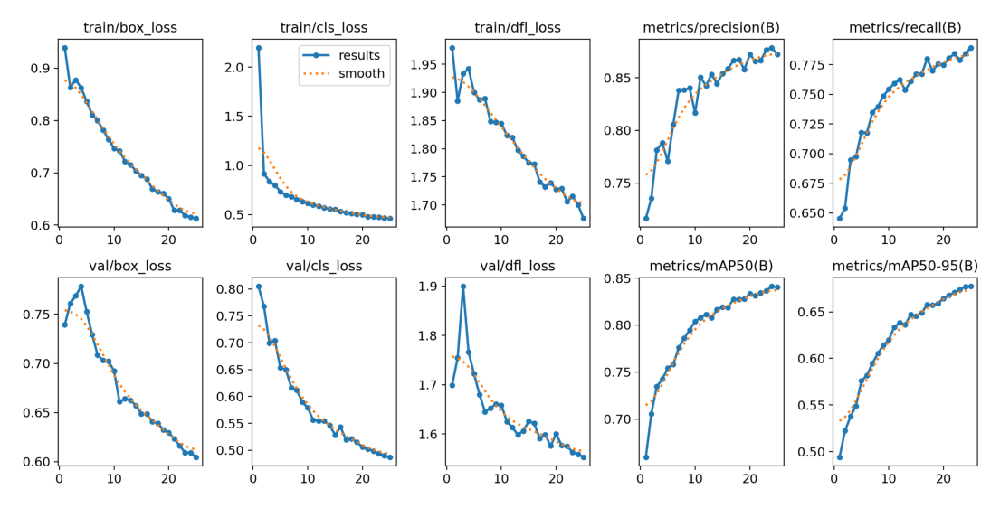

In [ ]:
plt.figure(figsize=(14, 8))

img = Image.open(os.path.join(name_project, "results.png"))
plt.imshow(img)
plt.axis("off");

No overfitting is observed, as the training and validation losses are approximately equal in the final epochs. Additionally, in these last epochs, the losses for both datasets begin to plateau, with only slight decreases, and the validation metrics also stabilize or even decline. This indicates that the model is converging, suggesting that an optimal number of epochs has been chosen to achieve the best results in the shortest possible time.

### **Validation Dataset**

Although the model automatically generates validation metrics and graphs upon completing the training, this evaluation can also be performed using ``model.eval()``. By adding the argument ``verbose=True``, more detailed metrics for each class will be printed to the screen.

In [ ]:
path_eval_val = os.path.join(name_project, "eval_val")

results_val = model.val(
    data=os.path.join(path_dataset, "data_val.yaml"),
    name=path_eval_val,
    verbose=True
)

Ultralytics 8.3.29 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/datasets/DIOR-R/val/labels.cache... 5863 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5863/5863 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 367/367 [04:25<00:00,  1.38it/s]


                   all       5863      35439      0.871       0.79       0.84      0.678
              airplane        337        650       0.97      0.958      0.977      0.943
               airport        327        334      0.696      0.673      0.676      0.329
        baseball field        577       1139      0.973      0.943      0.975      0.944
      basketball court        330        516      0.934      0.874      0.917      0.879
                bridge        499        861      0.847       0.54      0.661      0.451
               chimney        204        307      0.976      0.912      0.944      0.875
                   dam        246        260      0.592      0.538      0.528      0.246
expressway service area        281        543      0.964      0.683      0.833      0.644
expressway toll station        299        318       0.97      0.623      0.729      0.642
           golf course        239        274      0.831      0.803      0.873      0.643
    ground track fi

### **Test Dataset**

In [ ]:
path_eval_test = os.path.join(name_project, "eval_test")

results_test = model.val(
    data=os.path.join(path_dataset, "data_test.yaml"),
    name=path_eval_test,
    verbose=True
)

Ultralytics 8.3.29 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11l-obb summary (fused): 483 layers, 26,143,183 parameters, 0 gradients, 90.3 GFLOPs


val: Scanning /content/datasets/DIOR-R/test/labels... 11738 images, 0 backgrounds, 0 corrupt: 100%|██████████| 11738/11738 [00:49<00:00, 237.27it/s]


val: New cache created: /content/datasets/DIOR-R/test/labels.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 734/734 [08:44<00:00,  1.40it/s]


                   all      11738     124445      0.839      0.699      0.769      0.595
              airplane        705       8212      0.989      0.838      0.961       0.85
               airport        657        666      0.648      0.644      0.647      0.303
        baseball field       1311       3434      0.959      0.729      0.868      0.803
      basketball court        705       2146      0.941        0.9      0.941      0.894
                bridge       1299       2589      0.781      0.469      0.588      0.364
               chimney        447       1031      0.951      0.765      0.833      0.745
                   dam        503        538      0.511      0.511      0.469      0.209
expressway service area        565       1085      0.964      0.569      0.735      0.544
expressway toll station        634        688      0.968       0.53      0.634      0.555
           golf course        491        575      0.823       0.81      0.839      0.618
    ground track fi

The model achieved an **mAP50** of **0.84** and an **mAP50-95** of **0.678** on the validation set, and an **mAP50** of **0.769** and an **mAP50-95** of **0.595** on the test set, indicating strong performance. Furthermore, precision is slightly higher than recall in both sets, suggesting the model tends to produce more false negatives than false positives. This indicates that the model has slightly more difficulty detecting all present instances in the images compared to detecting instances that are absent. Across all classes, the model achieves an **mAP50** above 0.5, except for the `dam` class in the test set, where it reaches 0.469, likely due to its status as one of the three least represented classes in the training set. However, other minority classes, such as `train station` and `golf course`, show good performance with an **mAP50** above 0.75. Despite the low representation of these classes, the use of **Distribution Focal Loss (DFL)** has helped to alleviate the issue.



### **Confusion Matrix**

The calculation of the confusion matrix in object detection is more complex than in image classification, as it considers not only the confidence score but also the overlap area of each prediction. Additionally, it includes a class called ``background`` that does not belong to any of the dataset classes. The confusion matrix provides a detailed analysis of the results, showing counts of true positives, false positives, and false negatives for each class, from which the precision and recall of the model in the validation set are derived.


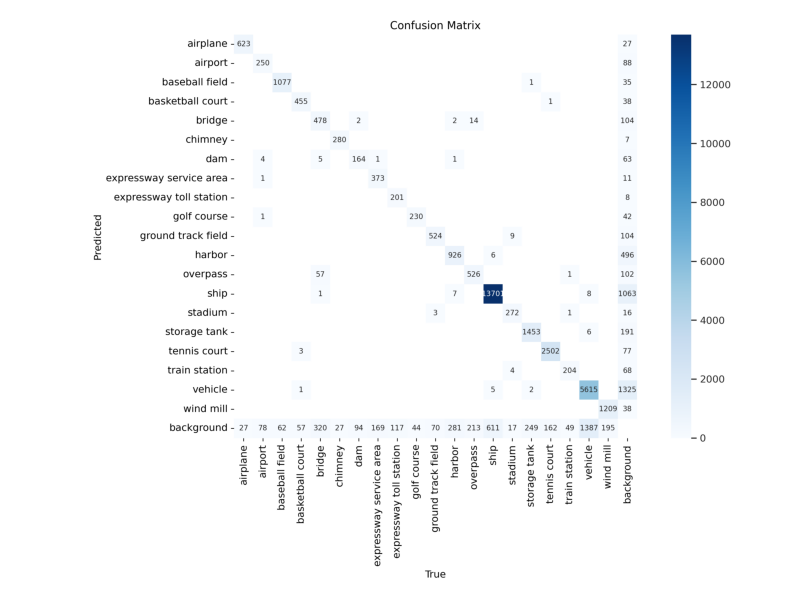

In [ ]:
plt.figure(figsize=(10, 10))

img = Image.open(os.path.join(path_eval_val, "confusion_matrix.png"))
plt.imshow(img)
plt.axis("off");

## **Inference with the Trained Model**

Inference with a fine-tuned YOLO model from Ultralytics is straightforward, as it supports predictions from a wide range of image and video formats. Additionally, results are displayed graphically and can be obtained in real time. All supported formats are detailed in the [official Ultralytics documentation](https://docs.ultralytics.com/modes/predict/#inference-sources). However, as mentioned earlier, for image inference and as an additional challenge to achieve a more aesthetic presentation, the results will be manually plotted.

In [ ]:
# Load the trained model
model = YOLO(os.path.join(name_project, "weights/best.pt"))

In [ ]:
# Function to download images from the internet
def download_images(url_list):
  images = []
  for i, url in enumerate(url_list):
    response = requests.get(url)
    name = f"image_{i}.jpg"

    with open(name, "wb") as f:
      f.write(response.content)
    images.append(name)

  return images


# Function for image inference
def object_detection(images, n_rows=2, url=False, with_conf=True, save=False, path_save=""):
  if url:
    images = download_images(images)

  images = np.random.choice(images, size=n_rows, replace=False)
  results = model.predict(
      source=images.tolist(),
      imgsz=640,
      save=False,
      save_txt=True,
      save_conf=with_conf,
      verbose=False
  )

  clear_output(wait=False)
  annotations = [
      os.path.join("/content/runs/obb/predict/labels", f'{image.split("/")[-1].split(".")[0]}.txt')
      for image in images
  ]
  plot_image_annotation(images, annotations, with_conf, save, path_save)
  shutil.rmtree("/content/runs/")

### **Validation Dataset**

In [ ]:
# Extract all the paths of the validation images
images_val = glob(os.path.join(path_dataset, "val/images/*.jpg"))

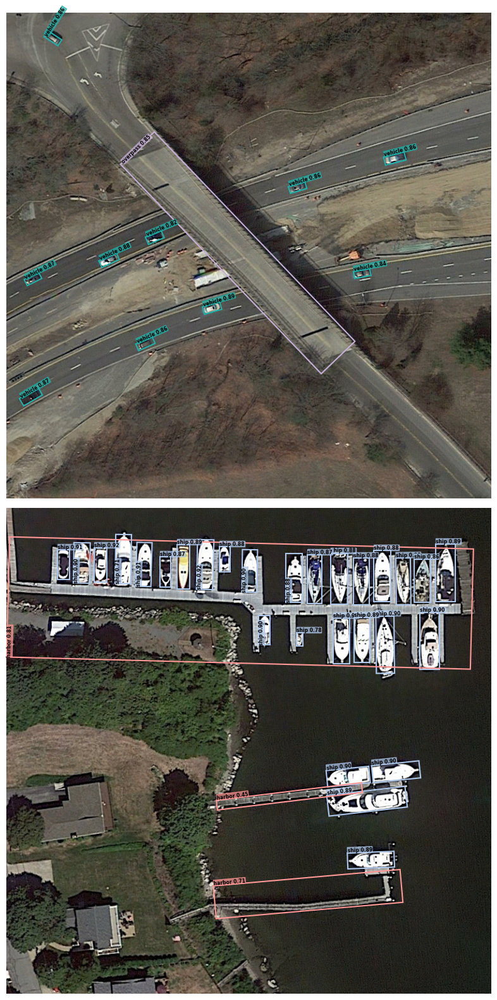

In [ ]:
object_detection(images_val, save=True, path_save="OBB_ObjectDetection_YOLO11l_DIOR-R_1.png")

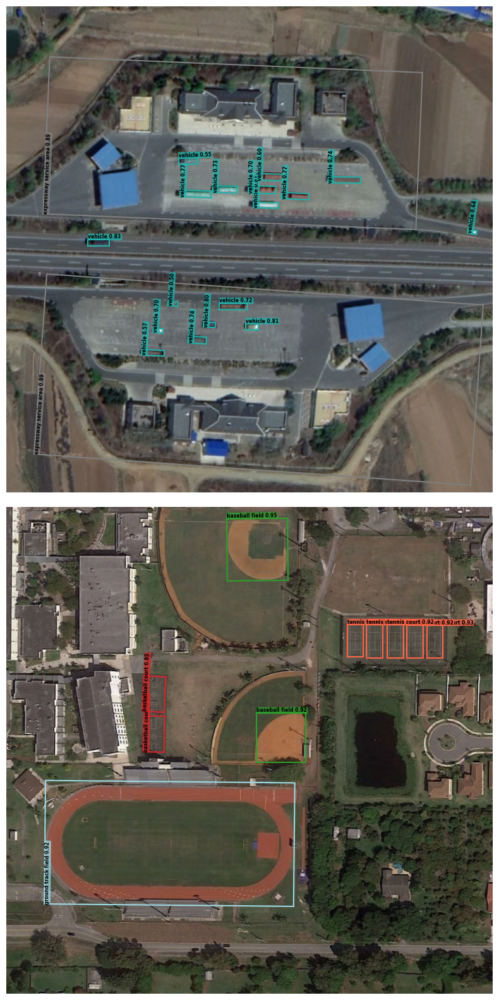

In [ ]:
object_detection(images_val)

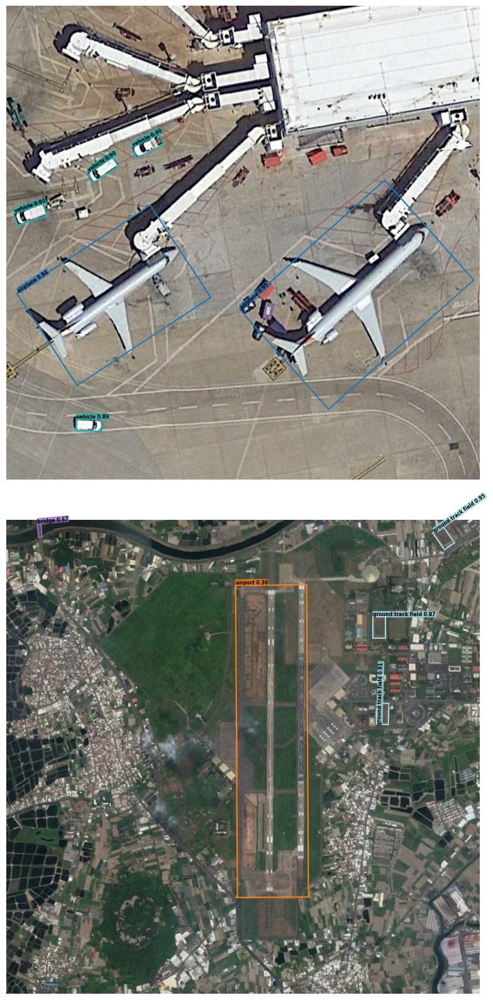

In [ ]:
object_detection(images_val)

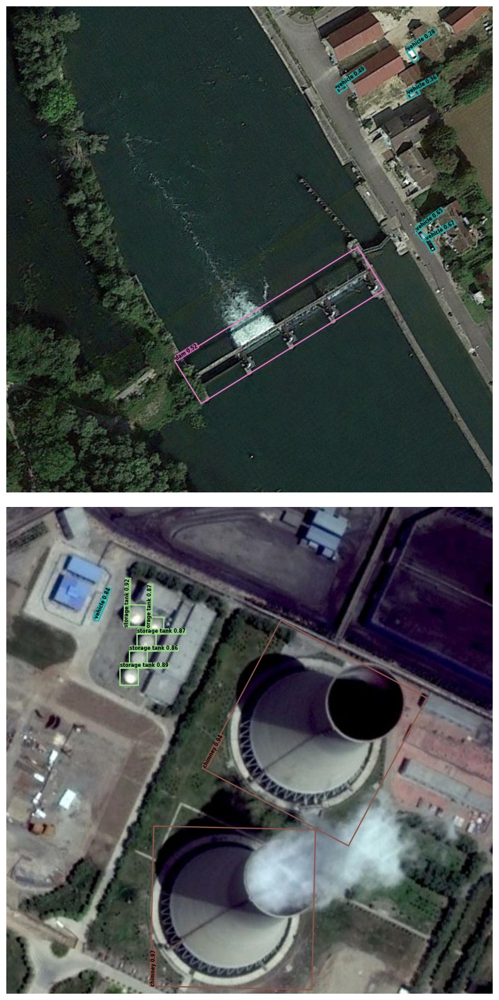

In [ ]:
object_detection(images_val)

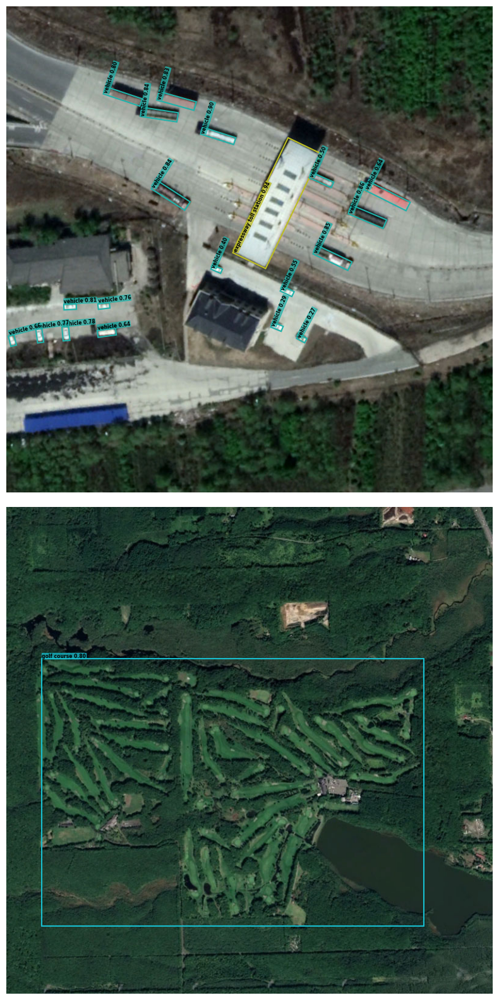

In [ ]:
object_detection(images_val)

### **Test Dataset**

In [ ]:
# Extract all the paths of the test images
images_test = glob(os.path.join(path_dataset, "test/images/*.jpg"))

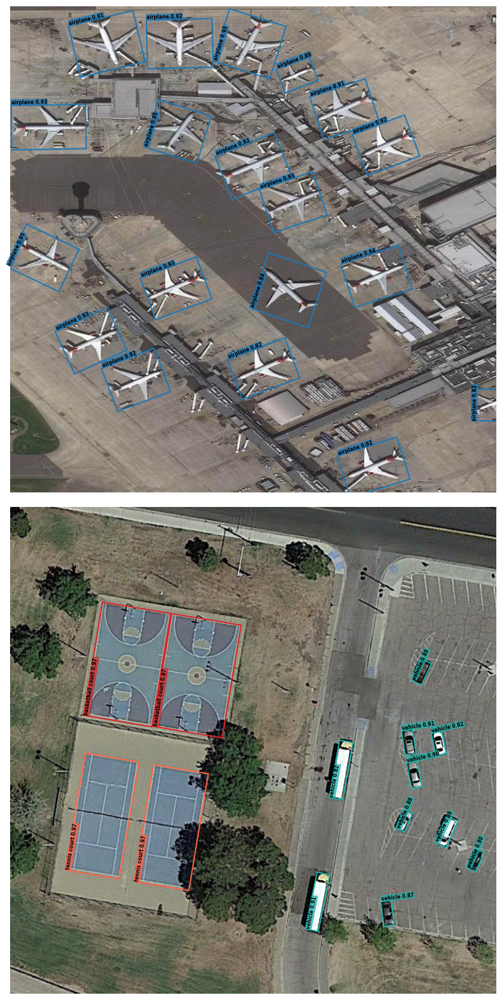

In [ ]:
object_detection(images_test, save=True, path_save="OBB_ObjectDetection_YOLO11l_DIOR-R_2.png")

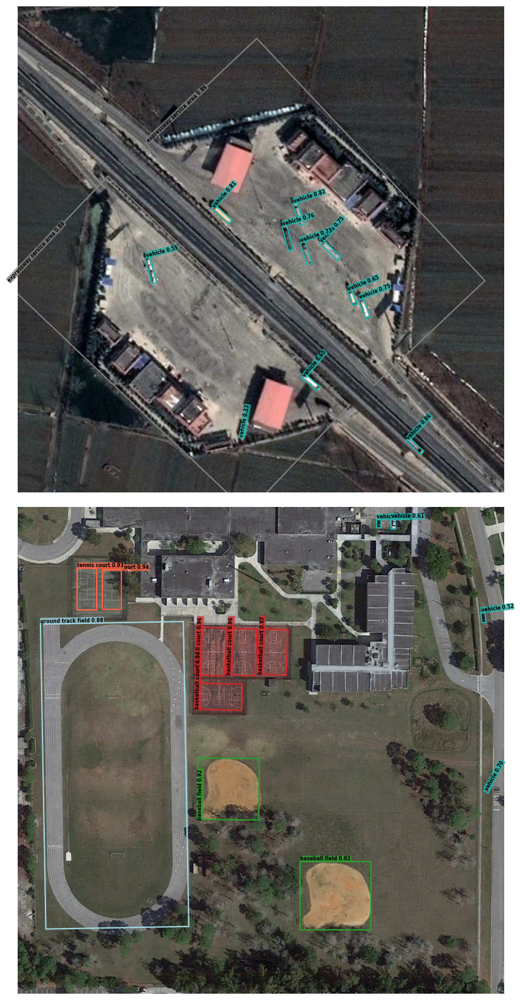

In [ ]:
object_detection(images_test)

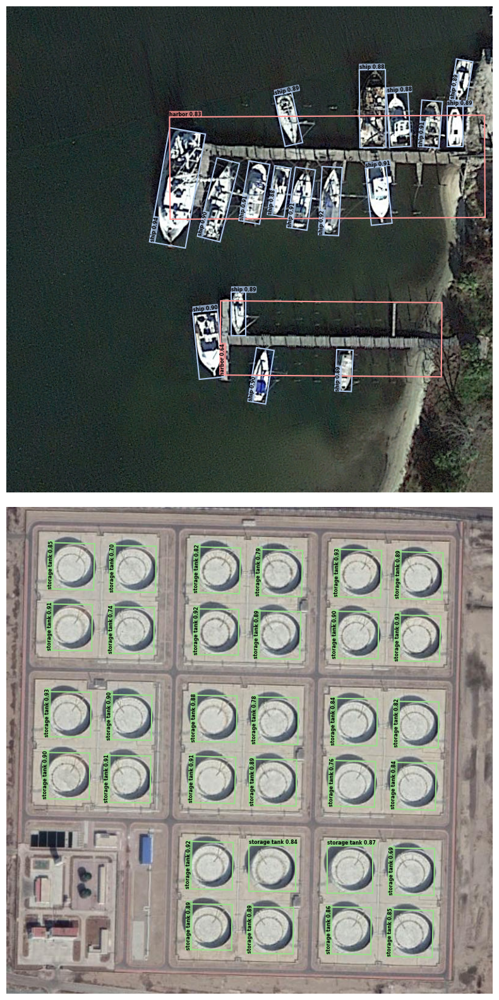

In [ ]:
object_detection(images_test)

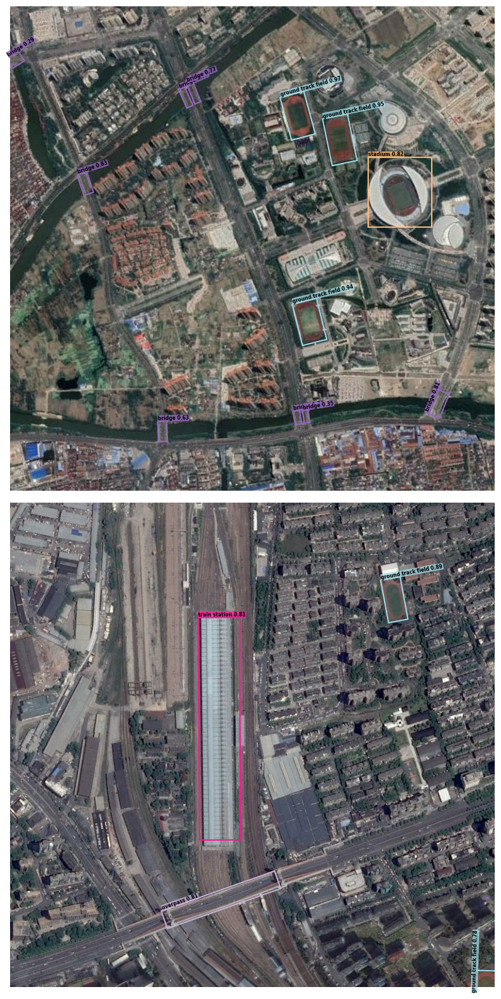

In [ ]:
object_detection(images_test)

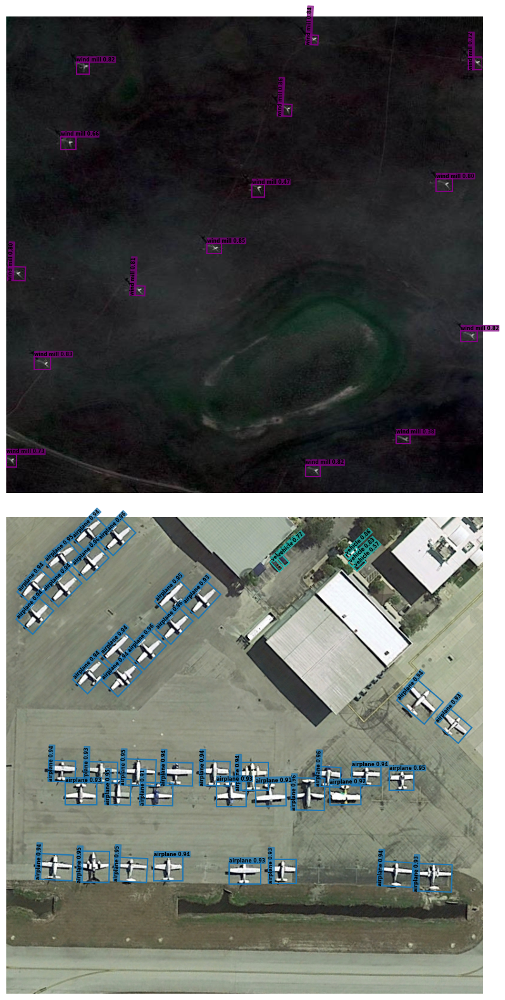

In [ ]:
object_detection(images_test)

### **Internet Images**

In [ ]:
url_images = [
    "https://videocdn.cdnpk.net/videos/08a179e1-f7ef-4484-882a-0cf4878f9f8b/horizontal/thumbnails/small.jpg?semt=ais_hybrid&item_id=188511",
    "https://media.istockphoto.com/id/1093807904/es/foto/r%C3%ADo-tambo-en-east-gippsland.jpg?s=170667a&w=0&k=20&c=YgYLmTlyn9f3bR_qrrn_aR0X0qQHnC84NO4epNvaOOQ=",
    "https://img.freepik.com/fotos-premium/vista-superior-refugio-contra-tifones-tuen-mun_328191-8637.jpg",
    "https://i1.kknews.cc/iQJKvh3wZTs3-X_UNqzMP8HaexAAj7eWznTSqxY/0.jpg",
    "https://img.freepik.com/premium-photo/restoration-large-road-construction-site-renovation-bridge-modern-road-interchange_73110-10382.jpg?w=360",
    "https://media.istockphoto.com/id/1328174539/photo/reservoir.jpg?s=612x612&w=0&k=20&c=ULK_XW5MBeWe0gquVxi_9BRmu_-4XtjS356dlwB9LUk="
]

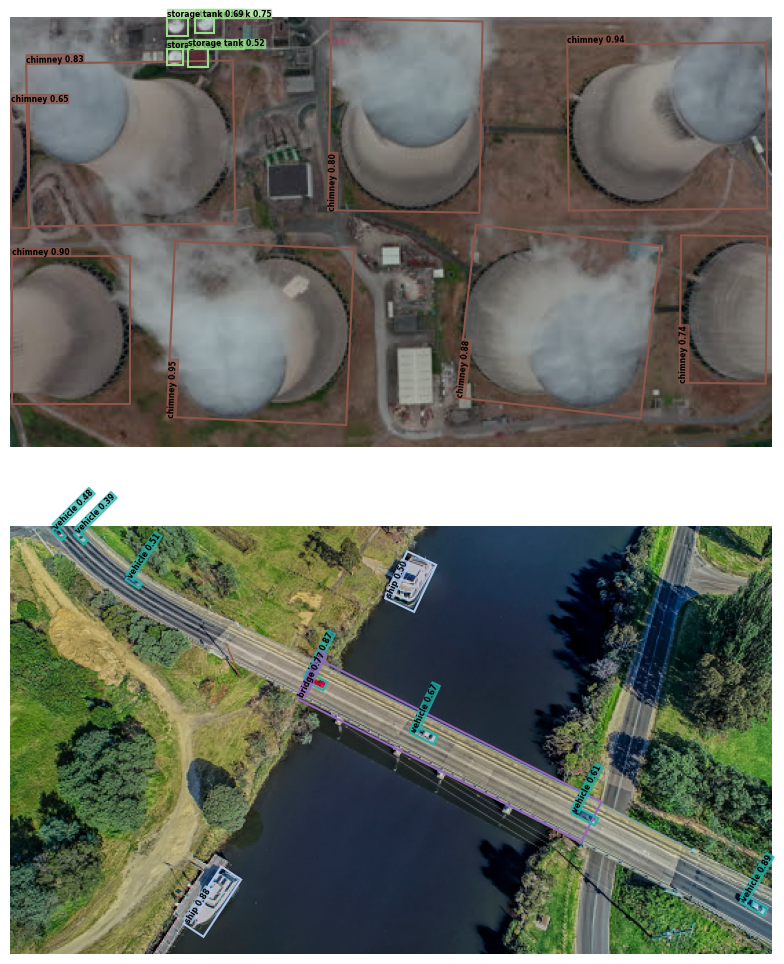

In [ ]:
object_detection(url_images[:2], url=True, save=True, path_save="OBB_ObjectDetection_YOLO11l_DIOR-R_3.png")

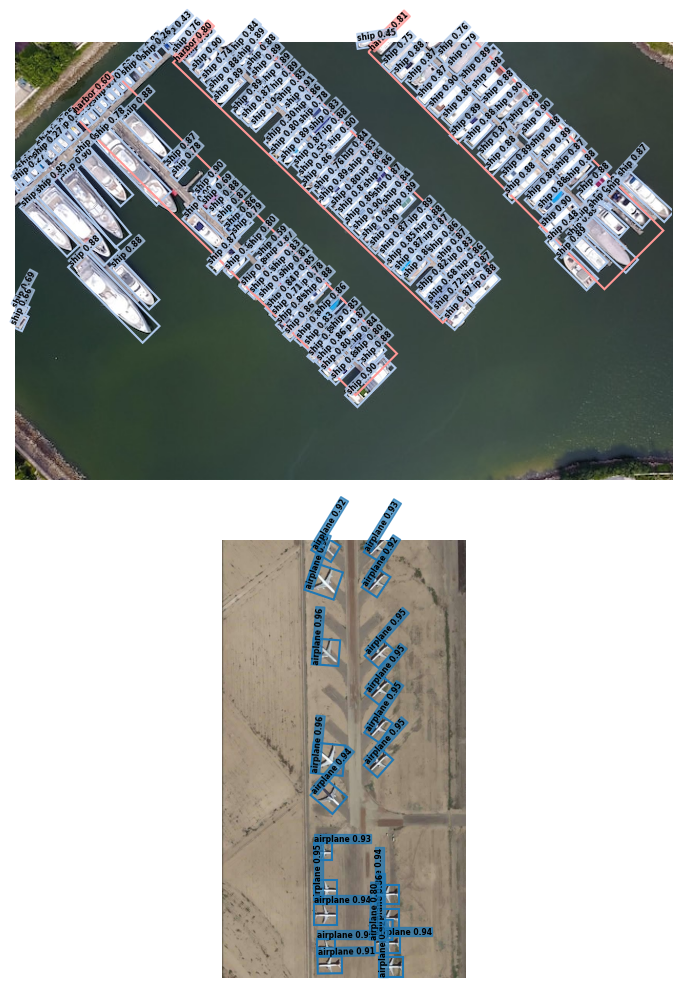

In [ ]:
object_detection(url_images[2:4], url=True)

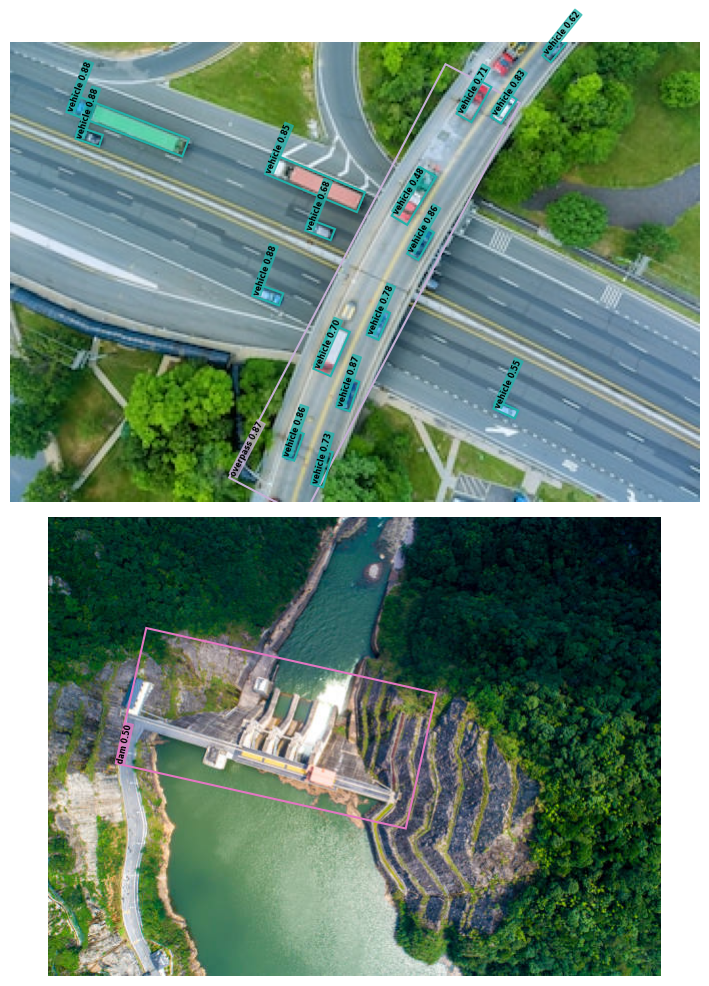

In [ ]:
object_detection(url_images[4:], url=True)

### **Video Inference**

The videos used for inference are downloaded from the [WIRESTOCK](https://wirestock.io/es) website.

In [ ]:
url_videos = [
    "/content/drive/MyDrive/Videos/ship_harbor_1.mp4",
    "/content/drive/MyDrive/Videos/ship_harbor_2.mp4",
]

In [ ]:
# Function for video inference
def object_detection_video(url_video, path_video, line_width=2):
  results = model.predict(
      source=url_video,
      imgsz=640,
      stream=False,
      stream_buffer=False,
      vid_stride=1,
      save=True,
      line_width=line_width,
      verbose=False
  )

  # Convert the video from AVI to MP4
  name = url_video.split("/")[-1].split(".")[0]
  path_results = os.path.join("/content/runs/obb/predict", f"{name}.avi")
  !ffmpeg -i $path_results $path_video -loglevel quiet -y

  !rm -r /content/runs/

  clear_output(wait=False)
  display(Video(path_video, embed=True, width=800, height=500))

In [ ]:
object_detection_video(url_videos[0], "OBB_ObjectDetection_YOLO11l_DIOR-R_1.mp4")

In [ ]:
object_detection_video(url_videos[1], "OBB_ObjectDetection_YOLO11l_DIOR-R_2.mp4", line_width=1)

## **Conclusion**

The **YOLO11l-OBB** model, fine-tuned with the **DIOR-R** dataset, achieved a **mAP50** of **0.84** and a **mAP50-95** of **0.678** on the validation dataset, and a **mAP50** of **0.769** and a **mAP50-95** of **0.595** on the test dataset. These results indicate excellent performance of the model. Based on the test dataset, the fine-tuned model would currently ranked first on the [Papers With Code](https://paperswithcode.com/sota/object-detection-in-aerial-images-on-dior-r) leaderboard, outperforming the **MAE+MTP** model, which achieved a **mAP50** of **0.7454**. This highlights the impressive performance of the YOLO11 models and the successful fine-tuning performed in this notebook.

